In [1]:
import pandas as pd

cassava_df = pd.read_csv('/home/alumno/Desktop/datos/Computer Vision/cassava/cassava_split.csv')

In [18]:
from torchvision import transforms
from torchvision.transforms import InterpolationMode
from torch.utils.data import Dataset, DataLoader
from PIL import Image
import lightning.pytorch as pl
from torchvision import transforms 
from torch.utils.data import Dataset, DataLoader, WeightedRandomSampler

# --- 1. CLASE CASSAVADATASET ---
class CassavaDataset(Dataset):
    """
    Dataset personalizado para el conjunto de datos de Cassava.
    """
    def __init__(self, df: pd.DataFrame, root_dir: str, transform=None):
        self.df = df
        self.root_dir = root_dir
        self.transform = transform

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        row = self.df.iloc[idx]
        img_name = row['image_id']
        label = int(row['label']) 
        
        img_path = os.path.join(self.root_dir, img_name)
        # Cargamos la imagen y aseguramos el formato RGB
        image = Image.open(img_path).convert('RGB') 
        
        if self.transform:
            image = self.transform(image)
        
        return image, torch.tensor(label, dtype=torch.long)

class CassavaDataModule(pl.LightningDataModule):
    def __init__(self, data_df: pd.DataFrame, image_dir: str, batch_size: int = 64):
        super().__init__()
        
        self.data_df = data_df
        self.image_dir = image_dir
        self.batch_size = batch_size
        
        # Now we transform to match the data the model was originally trained on
        self.transform = transforms.Compose([
             transforms.Resize(256),#, interpolation=InterpolationMode.BILINEAR),              
             transforms.CenterCrop(224),          
             transforms.ToTensor(),
             transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]) 
        ])


        
        

    def setup(self, stage: str):
        # 1. Filtrar el DataFrame basado en la columna 'set'
        train_df = self.data_df[self.data_df['set'] == 'train'].reset_index(drop=True)
        val_df = self.data_df[self.data_df['set'] == 'val'].reset_index(drop=True)
        test_df = self.data_df[self.data_df['set'] == 'test'].reset_index(drop=True)
        
        # 2. Creación de los objetos Dataset
        self.train_ds = CassavaDataset(train_df, self.image_dir, transform=self.transform)
        self.val_ds = CassavaDataset(val_df, self.image_dir, transform=self.transform)
        self.test_ds = CassavaDataset(test_df, self.image_dir, transform=self.transform)

        print(f"Dataset sizes: Train={len(self.train_ds)}, Val={len(self.val_ds)}, Test={len(self.test_ds)}")

    # Métodos para crear los DataLoaders
    def train_dataloader(self):
        # Extract labels from the dataset dataframe
        labels = self.train_ds.df['label'].values
    
        # Compute class frequencies
        class_sample_count = np.array([len(np.where(labels == t)[0]) for t in np.unique(labels)])
        # Inverse of frequency as weights
        weights = 1. / class_sample_count
        # Assign weight to each sample
        samples_weight = np.array([weights[t] for t in labels])
    
        # Define sampler
        sampler = WeightedRandomSampler(
            weights=torch.DoubleTensor(samples_weight),
            num_samples=len(samples_weight),
            replacement=True
        )
    
        return DataLoader(
            self.train_ds,
            batch_size=self.batch_size,
            sampler=sampler,
            num_workers=4
        )

    def val_dataloader(self):
        return DataLoader(self.val_ds, batch_size=self.batch_size, shuffle=False, num_workers = 4)

    def test_dataloader(self):
        return DataLoader(self.test_ds, batch_size=self.batch_size, shuffle=False, num_workers = 4)

ERROR! Session/line number was not unique in database. History logging moved to new session 99


In [3]:
class LightningModule(pl.LightningModule):
    def __init__(self, model, lr=1e-3, wd=0., discriminative_lr=None):
        super().__init__()
        self.model = model
        self.lr = lr
        self.wd = wd
        self.discriminative_lr = discriminative_lr # (lr, lr_mult)

        self.training_step_outputs = defaultdict(float)
        self.validation_step_outputs = defaultdict(float)

    def get_layer_wise_lr(self, lr, lr_mult):

        # Save layer names
        layer_names = []
        for idx, (name, param) in enumerate(self.model.named_parameters()):
            layer_names.append(name)
            print(f'{idx}: {name}')
        
        # Reverse layers
        layer_names.reverse()
        
        # placeholder
        parameters      = []
        prev_group_name = layer_names[0].split('.')[0]
        
        # store params & learning rates
        for idx, name in enumerate(layer_names):
            
            # parameter group name
            cur_group_name = name.split('.')[0]
            
            # update learning rate
            if cur_group_name != prev_group_name:
                lr *= lr_mult
            prev_group_name = cur_group_name
            
            # display info
            print('Using discriminative learning rates')
            print(f'{idx}: lr = {lr:.6f}, {name}')
            
            # append layer parameters
            parameters += [{'params': [p for n, p in model.named_parameters() if n == name and p.requires_grad],
                            'lr':     lr}]

        return parameters
        

    def forward(self, x):
        return self.model(x)

    def configure_optimizers(self):
        
        return torch.optim.Adam(
            self.parameters() if self.discriminative_lr == None else self.get_layer_wise_lr(*self.discriminative_lr), 
            lr=self.lr, weight_decay=self.wd)

    def training_step(self, batch, batch_idx):
        x, y = batch
        logits = self(x)
        loss = F.cross_entropy(logits, y)
        self.log('train_loss', loss, on_step=False, on_epoch=True)
        
        self.training_step_outputs['loss'] += loss.detach().cpu()
        self.training_step_outputs['steps'] += 1
            
        return loss

    def validation_step(self, batch, batch_idx):
        x, y = batch
        logits = self(x)
        loss = F.cross_entropy(logits, y)
        self.log('val_loss', loss, on_step=False, on_epoch=True)

        self.validation_step_outputs['loss'] += loss.detach().cpu()
        self.validation_step_outputs['steps'] += 1
        
        return loss

    def on_train_epoch_end(self): 
        avg_loss = self.training_step_outputs['loss'] / self.training_step_outputs['steps']
        print(f"Average training loss for epoch {self.current_epoch}: {avg_loss.item():.4f}")
        self.training_step_outputs.clear() 

    def on_validation_epoch_end(self):
        avg_loss = self.validation_step_outputs['loss'] / self.validation_step_outputs['steps']
        print(f"Average validation loss for epoch {self.current_epoch}: {avg_loss.item():.4f}")
        self.validation_step_outputs.clear()

In [4]:
IMAGE_ROOT_DIR = '/home/alumno/Desktop/datos/Computer Vision/cassava/images'

In [5]:
from torchvision import models
from torchvision.models import ResNet18_Weights
import torch
from torch import nn
from collections import defaultdict

data_module = CassavaDataModule(cassava_df, IMAGE_ROOT_DIR)
data_module.setup('fit')

ckpt_path = "/home/alumno/Desktop/datos/Computer Vision/lab 1/cassava_resnet18_tl_ft_disc_lr/version_0/checkpoints/best_valid_loss.ckpt"

model = models.resnet18(weights=ResNet18_Weights.IMAGENET1K_V1)

num_in_feat = model.fc.in_features
model.fc = nn.Linear(num_in_feat, 5)

# Load the best model. Note that we need to include all the LightningMNISTClassifier's __init__ parameters
model = LightningModule.load_from_checkpoint(ckpt_path, model=model)
model.cuda(0) # Move to GPU

# Move to GPU if needed
model.eval()


Dataset sizes: Train=14977, Val=3210, Test=3210


LightningModule(
  (model): ResNet(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, tra

Acc.: 0.8109


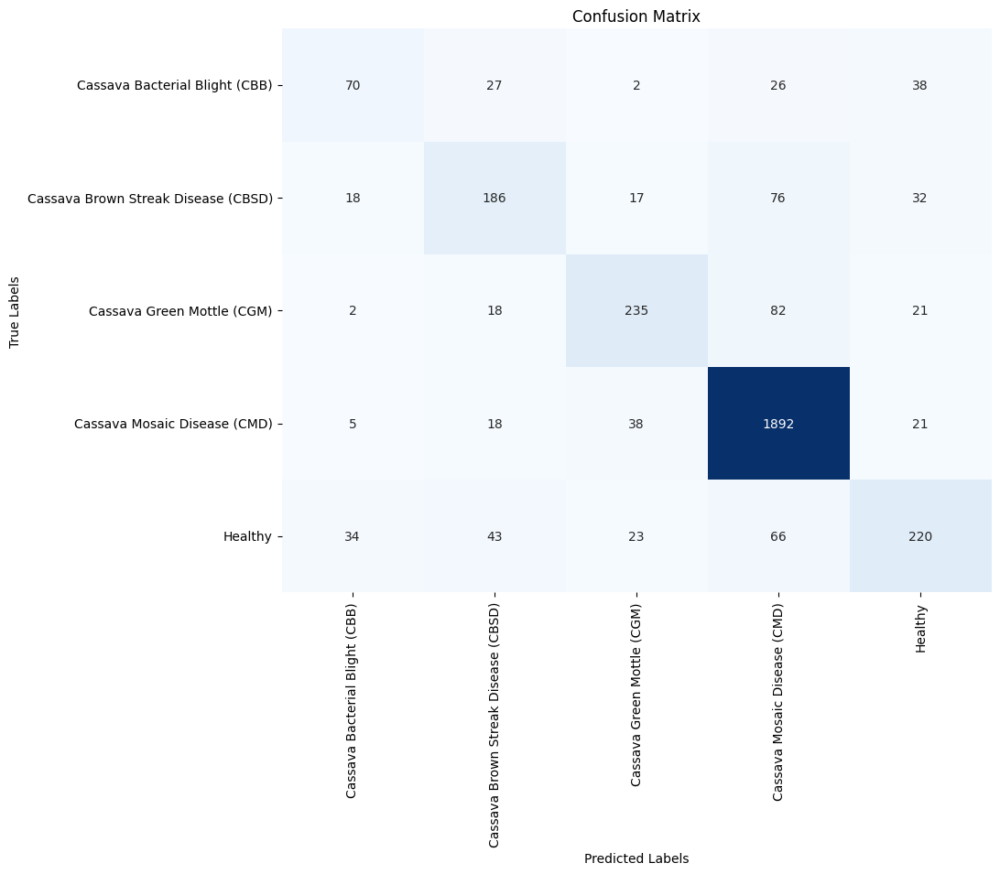

In [6]:
from sklearn.metrics import accuracy_score, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
import os

y_trues, y_hats = [], []

for (x, y_true) in iter(data_module.test_dataloader()):

    with torch.no_grad():
        y_hat_logits = model(x.cuda())
        y_hat = nn.Softmax(1)(y_hat_logits).argmax(1)
        y_hat = y_hat.detach().cpu()

    y_hats.append(y_hat)
    y_trues.append(y_true)

y_trues = torch.cat(y_trues)
y_hats = torch.cat(y_hats)

print(f'Acc.: {accuracy_score(y_trues, y_hats):.4f}')

class_names = {
    0: "Cassava Bacterial Blight (CBB)",
    1: "Cassava Brown Streak Disease (CBSD)",
    2: "Cassava Green Mottle (CGM)",
    3: "Cassava Mosaic Disease (CMD)",
    4: "Healthy"
}
class_labels = list(class_names.values())
cm = confusion_matrix(y_trues, y_hats, labels=torch.arange(5))

plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", cbar=False, xticklabels=class_labels, yticklabels=class_labels)
plt.title("Confusion Matrix")
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.savefig("Confusion_matrix_4", dpi=400)
plt.show()

Accuracy: 0.8109
F1 Score (macro): 0.6618
Precision (macro): 0.6943
Recall (macro): 0.6359


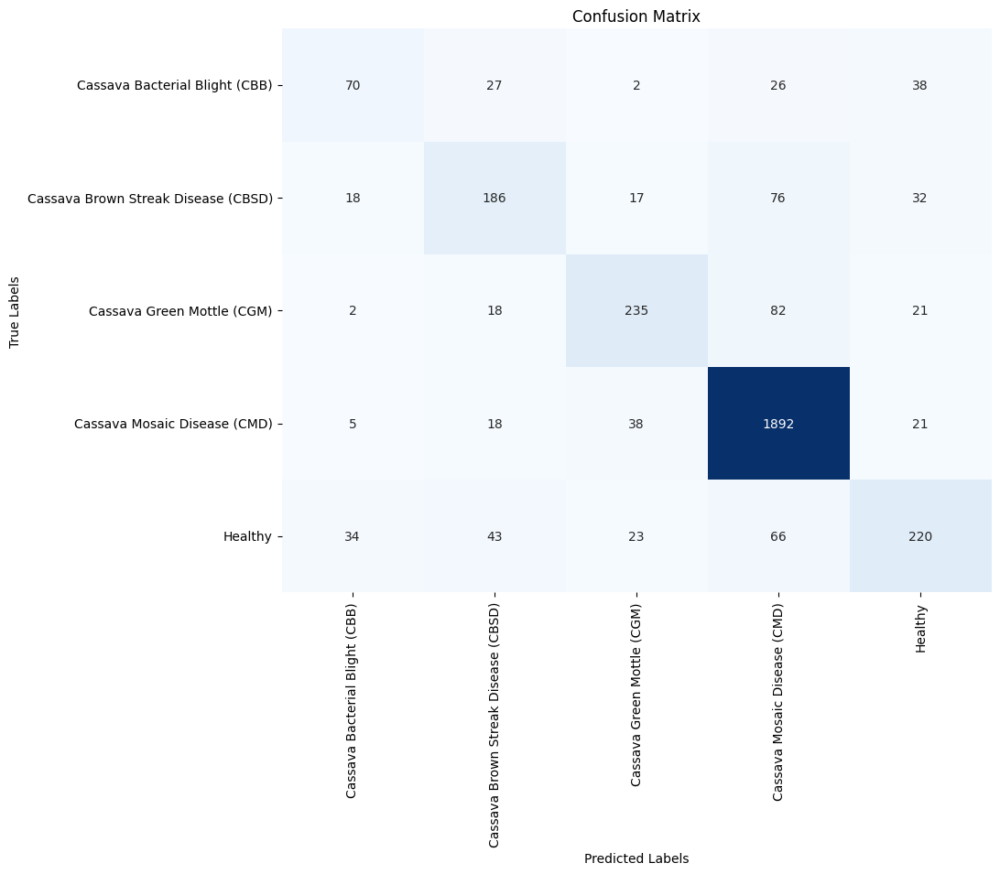

In [7]:
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, confusion_matrix
import seaborn as sns
import torch.nn as nn
import matplotlib.pyplot as plt

y_trues, y_hats = [], []

for (x, y_true) in iter(data_module.test_dataloader()):
    x = x.cuda()
    with torch.no_grad():
        y_hat_logits = model(x)
        y_hat = nn.Softmax(1)(y_hat_logits).argmax(1).cpu()

    y_hats.append(y_hat)
    y_trues.append(y_true)

y_trues = torch.cat(y_trues)
y_hats = torch.cat(y_hats)

# Accuracy
print(f'Accuracy: {accuracy_score(y_trues, y_hats):.4f}')
# F1, Precision, Recall (macro for multi-class)
print(f'F1 Score (macro): {f1_score(y_trues, y_hats, average="macro"):.4f}')
print(f'Precision (macro): {precision_score(y_trues, y_hats, average="macro"):.4f}')
print(f'Recall (macro): {recall_score(y_trues, y_hats, average="macro"):.4f}')

# Confusion Matrix
class_labels = list(class_names.values())
cm = confusion_matrix(y_trues, y_hats, labels=torch.arange(len(class_labels)))

plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", cbar=False, xticklabels=class_labels, yticklabels=class_labels)
plt.title("Confusion Matrix")
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.show()


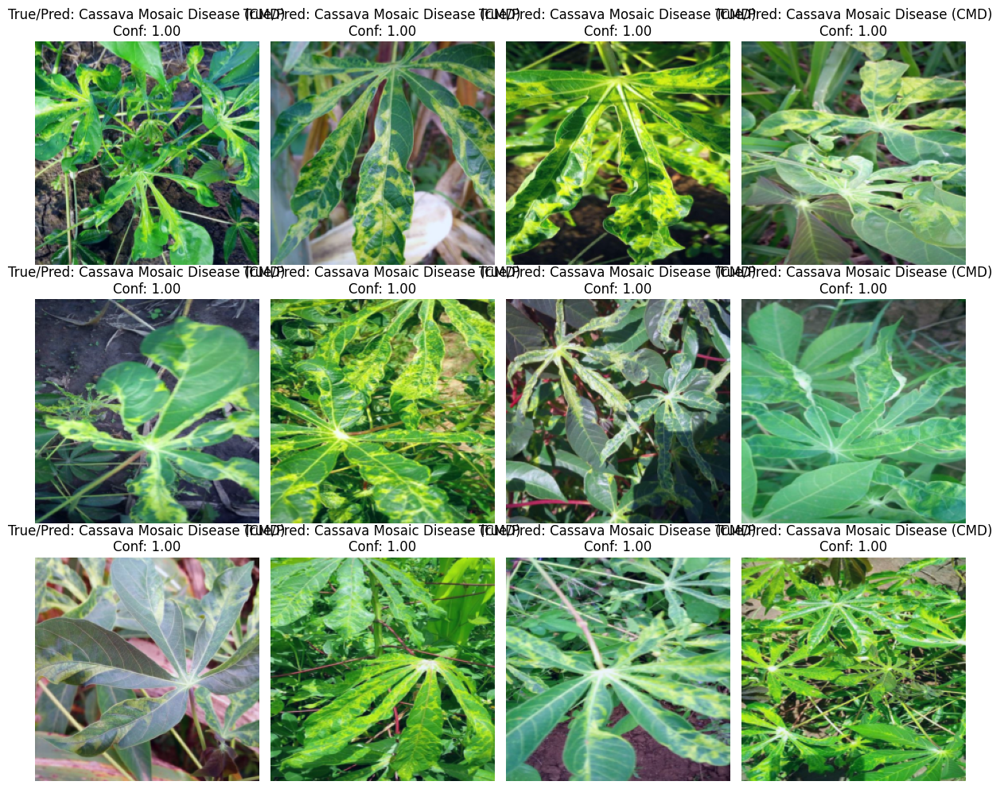

In [8]:
import torch
import matplotlib.pyplot as plt
import torch.nn as nn

correct_images, correct_preds, true_labels, confidences = [], [], [], []

for (x, y_true) in iter(data_module.test_dataloader()):
    x = x.cuda()
    with torch.no_grad():
        y_hat_logits = model(x)
        probs = nn.Softmax(1)(y_hat_logits)
        conf, y_hat = probs.max(1)

    # Move to CPU
    conf = conf.cpu()
    y_hat = y_hat.cpu()
    y_true = y_true.cpu()

    # Identify correctly classified samples
    correct_mask = y_hat == y_true
    if correct_mask.any():
        correct_images.append(x[correct_mask].cpu())
        correct_preds.append(y_hat[correct_mask])
        true_labels.append(y_true[correct_mask])
        confidences.append(conf[correct_mask])

# Concatenate across batches
correct_images = torch.cat(correct_images)
correct_preds = torch.cat(correct_preds)
true_labels = torch.cat(true_labels)
confidences = torch.cat(confidences)

# Sort by confidence (highest confidence first)
sorted_idx = torch.argsort(confidences, descending=True)
correct_images = correct_images[sorted_idx]
correct_preds = correct_preds[sorted_idx]
true_labels = true_labels[sorted_idx]
confidences = confidences[sorted_idx]

# Plot top-N best classified images
N = 12
plt.figure(figsize=(12, 10))
for i in range(min(N, len(correct_images))):
    img = correct_images[i].permute(1, 2, 0).numpy()
    img = (img - img.min()) / (img.max() - img.min())  # normalize for display
    plt.subplot(3, 4, i+1)
    plt.imshow(img)
    plt.title(f"True/Pred: {class_names[true_labels[i].item()]}\nConf: {confidences[i]:.2f}")
    plt.axis('off')

plt.tight_layout()
plt.show()


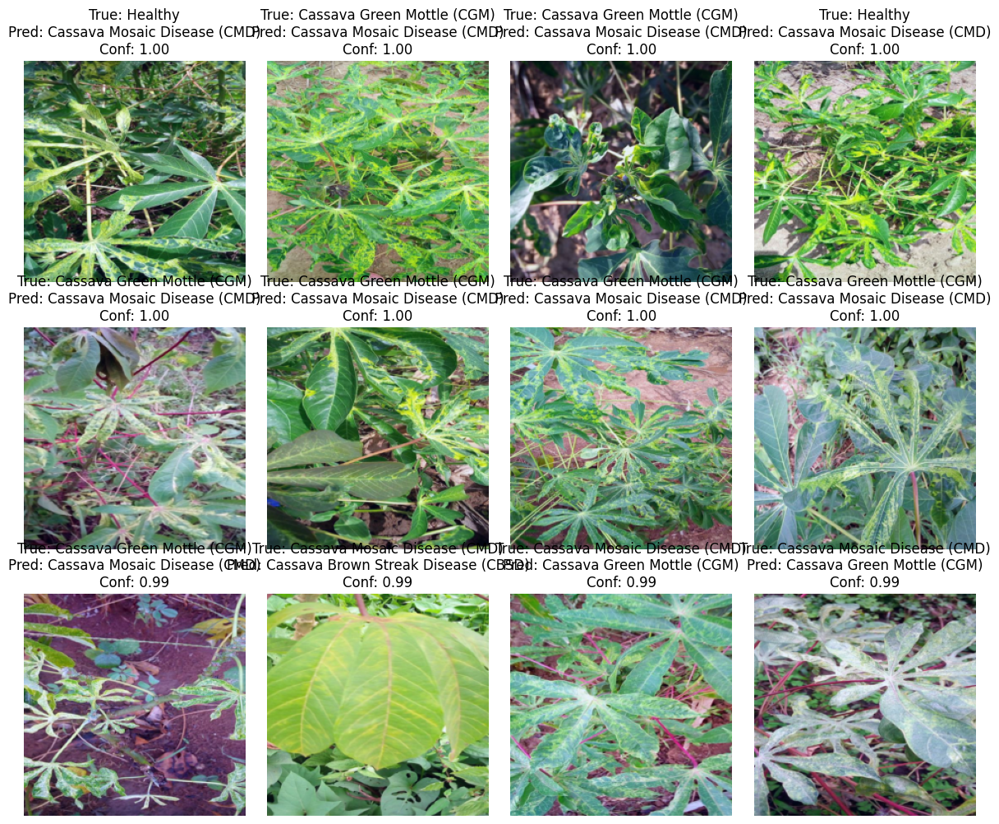

In [9]:
import torch
import matplotlib.pyplot as plt
from torchvision import transforms
from PIL import Image

# Assuming you already have y_trues, y_hats, and model defined.
# We'll collect predictions with their confidence scores.

wrong_images, wrong_preds, true_labels, confidences = [], [], [], []

transform = data_module.transform  # same preprocessing used during training

for (x, y_true) in iter(data_module.test_dataloader()):
    x = x.cuda()
    with torch.no_grad():
        y_hat_logits = model(x)
        probs = nn.Softmax(1)(y_hat_logits)
        conf, y_hat = probs.max(1)
    
    # Move to CPU
    conf = conf.cpu()
    y_hat = y_hat.cpu()
    y_true = y_true.cpu()
    
    # Identify misclassified samples
    wrong_mask = y_hat != y_true
    if wrong_mask.any():
        wrong_images.append(x[wrong_mask].cpu())
        wrong_preds.append(y_hat[wrong_mask])
        true_labels.append(y_true[wrong_mask])
        confidences.append(conf[wrong_mask])

# Concatenate across batches
wrong_images = torch.cat(wrong_images)
wrong_preds = torch.cat(wrong_preds)
true_labels = torch.cat(true_labels)
confidences = torch.cat(confidences)

# Sort by confidence (highest confidence errors first)
sorted_idx = torch.argsort(confidences, descending=True)
wrong_images = wrong_images[sorted_idx]
wrong_preds = wrong_preds[sorted_idx]
true_labels = true_labels[sorted_idx]
confidences = confidences[sorted_idx]

# Plot top-N worst classified images
N = 12  # number of images to show
class_names = list(class_names.values())

plt.figure(figsize=(12, 10))
for i in range(min(N, len(wrong_images))):
    img = wrong_images[i].permute(1, 2, 0).numpy()
    img = (img - img.min()) / (img.max() - img.min())  # normalize for display
    plt.subplot(3, 4, i+1)
    plt.imshow(img)
    plt.title(f"True: {class_names[true_labels[i].item()]}\nPred: {class_names[wrong_preds[i].item()]}\nConf: {confidences[i]:.2f}")
    plt.axis('off')
plt.tight_layout()
plt.show()


In [11]:
# from sklearn.metrics import roc_curve, auc
# from sklearn.preprocessing import label_binarize
# import matplotlib.pyplot as plt
# import torch.nn.functional as F
# import numpy as np

# # Assuming y_trues and y_probs are already collected as in your previous code
# n_classes = len(class_labels)

# # Binarize true labels
# y_true_onehot = F.one_hot(y_trues, num_classes=n_classes).numpy()
# y_probs_np = y_probs.numpy()

# # Plot ROC curves for each class
# plt.figure(figsize=(10, 8))
# for i in range(n_classes):
#     fpr, tpr, _ = roc_curve(y_true_onehot[:, i], y_probs_np[:, i])
#     roc_auc = auc(fpr, tpr)
#     plt.plot(fpr, tpr, lw=2, label=f'Class {class_labels[i]} (AUC = {roc_auc:.2f})')

# plt.plot([0, 1], [0, 1], 'k--', lw=2)  # Diagonal line
# plt.xlim([0.0, 1.0])
# plt.ylim([0.0, 1.05])
# plt.xlabel('False Positive Rate')
# plt.ylabel('True Positive Rate')
# plt.title('Multi-class ROC Curves')
# plt.legend(loc="lower right")
# plt.grid(True)
# plt.savefig("ROC_curves.png", dpi=400)
# plt.show()


# Data augmentation

In [12]:
import matplotlib.pyplot as plt
import torch
import numpy as np
from PIL import Image
import random

def visualize_transform_compare(dataset, transform, n=6):
    """
    Show original vs transformed images side by side for n random samples.
    """
    indices = random.sample(range(len(dataset)), n)
    
    fig, axes = plt.subplots(nrows=n, ncols=2, figsize=(8, 4*n))
    
    for i, idx in enumerate(indices):
        img_path = os.path.join(dataset.root_dir, dataset.df.iloc[idx]['image_id'])
        img = Image.open(img_path).convert('RGB')
        
        transformed_img = transform(img)
        
        # Convert tensors to numpy
        if isinstance(transformed_img, torch.Tensor):
            transformed_img = transformed_img.permute(1, 2, 0).numpy()
            transformed_img = (transformed_img - transformed_img.min()) / (transformed_img.max() - transformed_img.min())
        
        img_np = np.array(img) / 255.0  # normalize original for plotting
        
        # Original
        axes[i, 0].imshow(img_np)
        axes[i, 0].set_title("Original")
        axes[i, 0].axis('off')
        
        # Transformed
        axes[i, 1].imshow(transformed_img)
        axes[i, 1].set_title(f"Transformed: {transform.__class__.__name__}")
        axes[i, 1].axis('off')
    
    plt.tight_layout()
    plt.show()

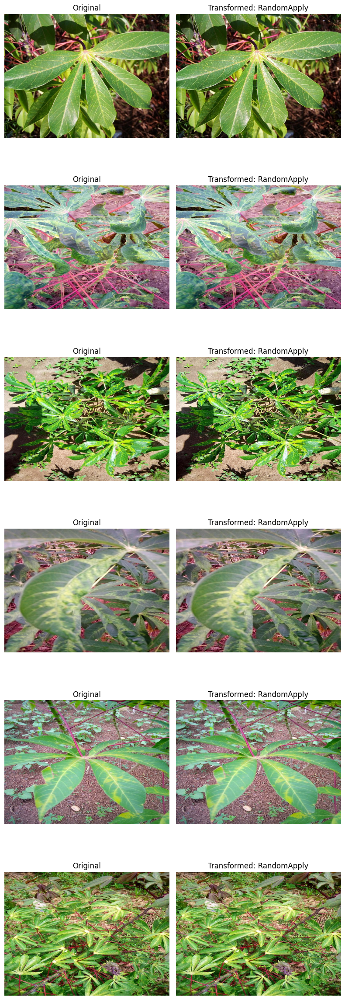

In [13]:
from PIL import ImageFilter

train_df = cassava_df[cassava_df['set'] == 'train'].reset_index(drop=True)
temp_dataset = CassavaDataset(train_df, root_dir=IMAGE_ROOT_DIR)

# single_transform = transforms.ColorJitter(brightness=0.5)
# visualize_transform_compare(temp_dataset, single_transform, n=6)


# Example: ColorJitter
# single_transform = transforms.ColorJitter(brightness=0.4, contrast=0.4, saturation=0.35)
# single_transform = transforms.GaussianBlur(kernel_size=(3,3), sigma=(0.1,1.2))
# single_transform = transforms.GaussianBlur(kernel_size=(3,3), sigma=(0,1.2))
single_transform = transforms.RandomApply(
    [transforms.ColorJitter(brightness=0.4, contrast=0.4, saturation=0.35)],
    p=0.8  # apply to only 50% of the images
)
single_transform = transforms.RandomApply(
    [transforms.GaussianBlur(kernel_size=(3,3), sigma=(0.1, 1.2))],
    p=0.2  # apply to only 50% of the images
)
single_transform = transforms.RandomApply(
    [transforms.Lambda(lambda img: img.filter(ImageFilter.SHARPEN))],
    p=0.5
)


visualize_transform_compare(temp_dataset, single_transform, n=6)


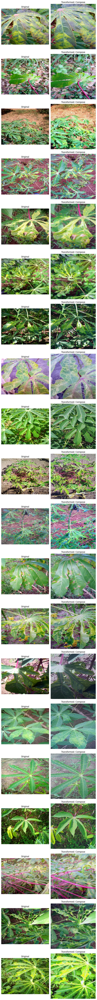

In [23]:
from torchvision import transforms
from PIL import ImageFilter

photogenic_transforms = transforms.Compose([
    # Resize and crop to standard size
    transforms.Resize(256),
    transforms.CenterCrop(224),
    
    # Color jitter: brightness, contrast, saturation (applied randomly)
    transforms.RandomApply(
        [transforms.ColorJitter(brightness=0.3, contrast=0.4, saturation=0.35)],
        p=0.8
    ),
    
    # Gaussian blur (applied randomly, mild)
    transforms.RandomApply(
        [transforms.GaussianBlur(kernel_size=(3,3), sigma=(0.1, 1.2))],
        p=0.2
    ),
    
    # Sharpen filter (applied randomly)
    transforms.RandomApply(
        [transforms.Lambda(lambda img: img.filter(ImageFilter.SHARPEN))],
        p=0.5
    ),
    
    # Convert to tensor and normalize
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

visualize_transform_compare(temp_dataset, photogenic_transforms, n=20)


# Train time

In [25]:
class CassavaDataModule(pl.LightningDataModule):
    def __init__(
        self, 
        data_df: pd.DataFrame, 
        image_dir: str, 
        batch_size: int = 64, 
        train_transform=None,
        val_transform=None,
        test_transform=None
    ):
        super().__init__()
        
        self.data_df = data_df
        self.image_dir = image_dir
        self.batch_size = batch_size
        
        # Use the provided transforms, otherwise default to simple resize+center crop+normalize
        default_transform = transforms.Compose([
             transforms.Resize(256),
             transforms.CenterCrop(224),
             transforms.ToTensor(),
             transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
        ])
        
        self.train_transform = train_transform or default_transform
        self.val_transform = val_transform or default_transform
        self.test_transform = test_transform or default_transform

    def setup(self, stage: str):
        # Filter DataFrame based on 'set' column
        train_df = self.data_df[self.data_df['set'] == 'train'].reset_index(drop=True)
        val_df = self.data_df[self.data_df['set'] == 'val'].reset_index(drop=True)
        test_df = self.data_df[self.data_df['set'] == 'test'].reset_index(drop=True)
        
        # Create dataset objects with the corresponding transforms
        self.train_ds = CassavaDataset(train_df, self.image_dir, transform=self.train_transform)
        self.val_ds = CassavaDataset(val_df, self.image_dir, transform=self.val_transform)
        self.test_ds = CassavaDataset(test_df, self.image_dir, transform=self.test_transform)

        print(f"Dataset sizes: Train={len(self.train_ds)}, Val={len(self.val_ds)}, Test={len(self.test_ds)}")

    def train_dataloader(self):
        labels = self.train_ds.df['label'].values
        class_sample_count = np.array([len(np.where(labels == t)[0]) for t in np.unique(labels)])
        weights = 1. / class_sample_count
        samples_weight = np.array([weights[t] for t in labels])
    
        sampler = WeightedRandomSampler(
            weights=torch.DoubleTensor(samples_weight),
            num_samples=len(samples_weight),
            replacement=True
        )
    
        return DataLoader(
            self.train_ds,
            batch_size=self.batch_size,
            sampler=sampler,
            num_workers=2
        )

    def val_dataloader(self):
        return DataLoader(self.val_ds, batch_size=self.batch_size, shuffle=False, num_workers=2)

    def test_dataloader(self):
        return DataLoader(self.test_ds, batch_size=self.batch_size, shuffle=False, num_workers=2)


Dataset sizes: Train=14977, Val=3210, Test=3210


LightningModule(
  (model): ResNet(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, tra

In [28]:
from torchvision import models
from torchvision.models import ResNet18_Weights
import torch
from torch import nn
from collections import defaultdict

data_module = CassavaDataModule(cassava_df, IMAGE_ROOT_DIR)
data_module.setup('fit')

ckpt_path = "/home/alumno/Desktop/datos/Computer Vision/lab 1/cassava_resnet18_tl_ft_disc_lr/version_0/checkpoints/best_valid_loss.ckpt"

model = models.resnet18(weights=ResNet18_Weights.IMAGENET1K_V1)

num_in_feat = model.fc.in_features
model.fc = nn.Linear(num_in_feat, 5)

# Load the best model. Note that we need to include all the LightningMNISTClassifier's __init__ parameters
model = LightningModule.load_from_checkpoint(ckpt_path, model=model)
model.cuda(0) # Move to GPU

# Move to GPU if needed
model.train()

from lightning.pytorch.loggers import CSVLogger
from lightning.pytorch.callbacks import LearningRateFinder, BatchSizeFinder, ModelCheckpoint, EarlyStopping

pl.seed_everything(42, workers=True)

# Wrap the model inside a LightningModule.
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

lightning_module = LightningModule(model, discriminative_lr=(1e-3, 0.1)).to(device)

# Define a CSV logger to store training/validation metrics in CSV format.
csv_logger = CSVLogger(save_dir=os.getcwd(), name="cassava_resnet18_photo_transforms_tl_ft_disc_lr")

lr_finder = LearningRateFinder(
    min_lr=1e-6,
    max_lr=1e-2,
    num_training_steps=30,
    mode='exponential',
    early_stop_threshold=10.0
)


bs_finder = BatchSizeFinder(
    mode='power',
    steps_per_trial=2,
    init_val=16,
    max_trials=3
)



model_checkpoint = ModelCheckpoint(
    monitor='val_loss',
    mode='min',
    save_top_k=1,
    save_last=True,
    verbose=False
)

early_stopping = EarlyStopping(
    monitor="val_loss",
    min_delta=0.001,
    patience=5,
    verbose=True,
    mode="min"
)

# Define a checkpoint callback:
# It will save the model with the lowest validation loss ("best_valid_loss.ckpt").
model_checkpoint_callback = pl.callbacks.model_checkpoint.ModelCheckpoint(
    monitor='val_loss',mode='min', filename='best_valid_loss', verbose=True, save_last=False)

# Create a PyTorch Lightning trainer
trainer = pl.Trainer(max_epochs=5, logger=csv_logger, callbacks=[model_checkpoint_callback, lr_finder, bs_finder]) #limit_train_batches=2 es para que me entrene

# Load the data module
data_module = CassavaDataModule(cassava_df, IMAGE_ROOT_DIR, train_transform=photogenic_transforms)

# Train the model with the trainer, passing the core LightningModule and data module.
trainer.fit(lightning_module, data_module)

photogenic_transforms

Dataset sizes: Train=14977, Val=3210, Test=3210
ERROR! Session/line number was not unique in database. History logging moved to new session 100


Seed set to 42
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Dataset sizes: Train=14977, Val=3210, Test=3210
0: model.conv1.weight
1: model.bn1.weight
2: model.bn1.bias
3: model.layer1.0.conv1.weight
4: model.layer1.0.bn1.weight
5: model.layer1.0.bn1.bias
6: model.layer1.0.conv2.weight
7: model.layer1.0.bn2.weight
8: model.layer1.0.bn2.bias
9: model.layer1.1.conv1.weight
10: model.layer1.1.bn1.weight
11: model.layer1.1.bn1.bias
12: model.layer1.1.conv2.weight
13: model.layer1.1.bn2.weight
14: model.layer1.1.bn2.bias
15: model.layer2.0.conv1.weight
16: model.layer2.0.bn1.weight
17: model.layer2.0.bn1.bias
18: model.layer2.0.conv2.weight
19: model.layer2.0.bn2.weight
20: model.layer2.0.bn2.bias
21: model.layer2.0.downsample.0.weight
22: model.layer2.0.downsample.1.weight
23: model.layer2.0.downsample.1.bias
24: model.layer2.1.conv1.weight
25: model.layer2.1.bn1.weight
26: model.layer2.1.bn1.bias
27: model.layer2.1.conv2.weight
28: model.layer2.1.bn2.weight
29: model.layer2.1.bn2.bias
30: model.layer3.0.conv1.weight
31: model.layer3.0.bn1.weight
32

Finding best initial lr:   0%|          | 0/30 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_steps=30` reached.
Restoring states from the checkpoint path at /home/alumno/Desktop/datos/Computer Vision/lab 1/cassava_resnet18_tl_ft_disc_lr/version_1/.lr_find_f0e8901a-dfd8-4b0a-85ee-466bf338ff4b.ckpt
Restored all states from the checkpoint at /home/alumno/Desktop/datos/Computer Vision/lab 1/cassava_resnet18_tl_ft_disc_lr/version_1/.lr_find_f0e8901a-dfd8-4b0a-85ee-466bf338ff4b.ckpt


Average training loss for epoch 0: 1.2347


Learning rate set to 7.356422544596413e-05
`Trainer.fit` stopped: `max_steps=2` reached.
Batch size 16 succeeded, trying batch size 32


Average training loss for epoch 0: 1.1526


`Trainer.fit` stopped: `max_steps=2` reached.
Batch size 32 succeeded, trying batch size 64


Average training loss for epoch 0: 1.3199


`Trainer.fit` stopped: `max_steps=2` reached.
Batch size 64 succeeded, trying batch size 128


Average training loss for epoch 0: 0.3107


Finished batch size finder, will continue with full run using batch size 128
Restoring states from the checkpoint path at /home/alumno/Desktop/datos/Computer Vision/lab 1/cassava_resnet18_tl_ft_disc_lr/version_1/.scale_batch_size_672e0d3f-9da9-47ee-b060-685111b5d7ab.ckpt
Restored all states from the checkpoint at /home/alumno/Desktop/datos/Computer Vision/lab 1/cassava_resnet18_tl_ft_disc_lr/version_1/.scale_batch_size_672e0d3f-9da9-47ee-b060-685111b5d7ab.ckpt

  | Name  | Type            | Params | Mode 
--------------------------------------------------
0 | model | LightningModule | 11.2 M | train
--------------------------------------------------
11.2 M    Trainable params
0         Non-trainable params
11.2 M    Total params
44.716    Total estimated model params size (MB)
69        Modules in train mode
0         Modules in eval mode
Restored all states from the checkpoint at /home/alumno/Desktop/datos/Computer Vision/lab 1/cassava_resnet18_tl_ft_disc_lr/version_1/.scale_batch_siz

Sanity Checking: |                                        | 0/? [00:00<?, ?it/s]

Average validation loss for epoch 0: 0.5542


Training: |                                               | 0/? [00:00<?, ?it/s]

Validation: |                                             | 0/? [00:00<?, ?it/s]

Epoch 0, global step 118: 'val_loss' reached 0.58590 (best 0.58590), saving model to '/home/alumno/Desktop/datos/Computer Vision/lab 1/cassava_resnet18_tl_ft_disc_lr/version_1/cassava_resnet18_photo_transforms_tl_ft_disc_lr/version_5/checkpoints/best_valid_loss.ckpt' as top 1


Average validation loss for epoch 0: 0.5706
Average training loss for epoch 0: 0.4958


Validation: |                                             | 0/? [00:00<?, ?it/s]

Epoch 1, global step 236: 'val_loss' was not in top 1


Average validation loss for epoch 1: 0.5744
Average training loss for epoch 1: 0.1999


Validation: |                                             | 0/? [00:00<?, ?it/s]

Epoch 2, global step 354: 'val_loss' was not in top 1


Average validation loss for epoch 2: 0.6534
Average training loss for epoch 2: 0.0993


Validation: |                                             | 0/? [00:00<?, ?it/s]

Epoch 3, global step 472: 'val_loss' was not in top 1


Average validation loss for epoch 3: 0.6580
Average training loss for epoch 3: 0.0688


Validation: |                                             | 0/? [00:00<?, ?it/s]

Epoch 4, global step 590: 'val_loss' was not in top 1
`Trainer.fit` stopped: `max_epochs=5` reached.


Average validation loss for epoch 4: 0.6421
Average training loss for epoch 4: 0.0432


Compose(
    Resize(size=256, interpolation=bilinear, max_size=None, antialias=True)
    CenterCrop(size=(224, 224))
    RandomApply(
    p=0.8
    ColorJitter(brightness=(0.7, 1.3), contrast=(0.6, 1.4), saturation=(0.65, 1.35), hue=None)
)
    RandomApply(
    p=0.2
    GaussianBlur(kernel_size=(3, 3), sigma=(0.1, 1.2))
)
    RandomApply(
    p=0.5
    Lambda()
)
    ToTensor()
    Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
)

ERROR! Session/line number was not unique in database. History logging moved to new session 101
Accuracy: 0.6598
F1 Score (macro): 0.5697
Precision (macro): 0.5359
Recall (macro): 0.6585


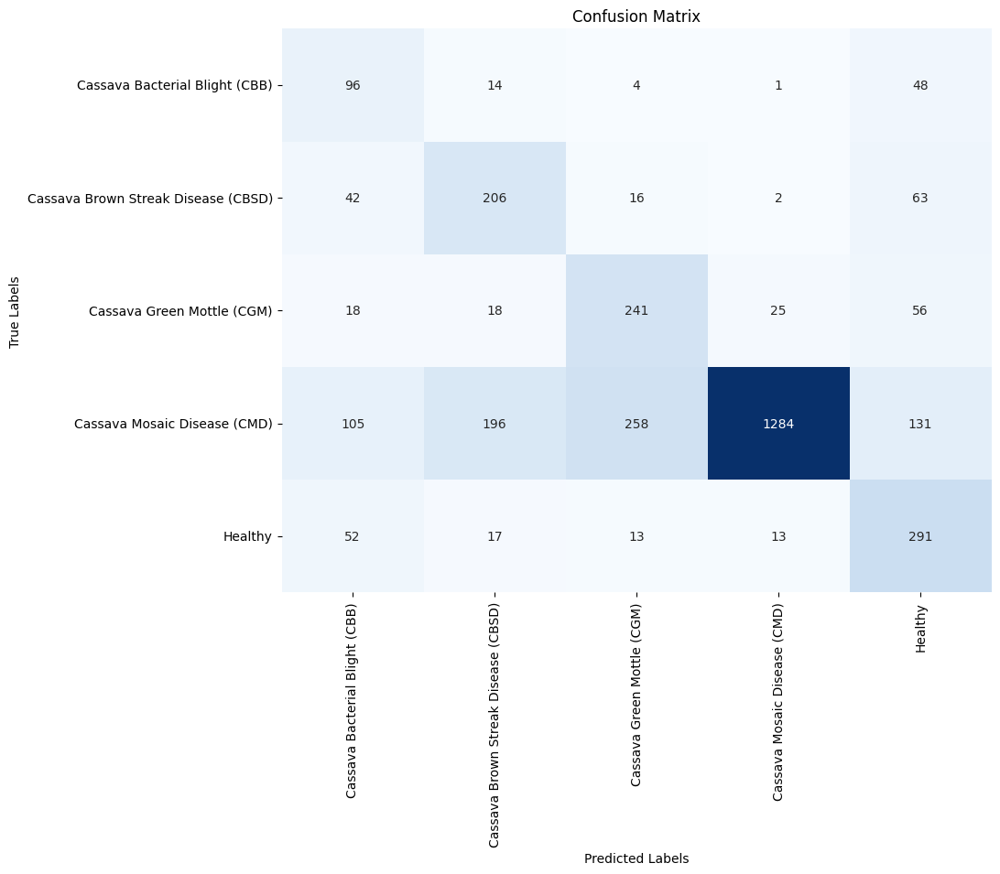

In [31]:
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, confusion_matrix
import seaborn as sns
import torch.nn as nn
import matplotlib.pyplot as plt

y_trues, y_hats = [], []

for (x, y_true) in iter(data_module.test_dataloader()):
    x = x
    with torch.no_grad():
        y_hat_logits = model(x)
        y_hat = nn.Softmax(1)(y_hat_logits).argmax(1).cpu()

    y_hats.append(y_hat)
    y_trues.append(y_true)

y_trues = torch.cat(y_trues)
y_hats = torch.cat(y_hats)

# Accuracy
print(f'Accuracy: {accuracy_score(y_trues, y_hats):.4f}')
# F1, Precision, Recall (macro for multi-class)
print(f'F1 Score (macro): {f1_score(y_trues, y_hats, average="macro"):.4f}')
print(f'Precision (macro): {precision_score(y_trues, y_hats, average="macro"):.4f}')
print(f'Recall (macro): {recall_score(y_trues, y_hats, average="macro"):.4f}')

# Confusion Matrix
# class_labels = list(class_names.values())
cm = confusion_matrix(y_trues, y_hats, labels=torch.arange(len(class_names)))

plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", cbar=False, xticklabels=class_names, yticklabels=class_names)
plt.title("Confusion Matrix")
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.show()

# Test time

In [ ]:
!uv pip install ttach

In [ ]:
import ttach as tta
tta_model = tta.SegmentationTTAWrapper(model, tta.aliases.d4_transform(), merge_mode='mean')

transforms